Chapter02 텐서플로 기초

03 즉시 실행 모드와 텐서 생성

04 텐서플로 연산

# TensorFlow Basics

https://www.tensorflow.org/guide/basics

TensorFlow is an end-to-end platform for machine learning

* Multidimensional-array based numeric computation
* GPU and distributed processing
* Automatic differentiation
* Model construction, training, and export


# 2.0 import tensorflow module

In [ ]:
import tensorflow as tf
import numpy as np

print(tf.__version__)

# 2.1 tensor

In [ ]:
# https://www.tensorflow.org/guide/tensor

# Tensors are multi-dimensional arrays with a uniform type (called a dtype)
# If you're familiar with NumPy, tensors are (kind of) like np.arrays.

# All tensors are immutable like Python numbers and strings:
# you can never update the contents of a tensor, only create a new one.

## 2.11 tf.constant

In [4]:
import tensorflow as tf
tensor_constant = tf.constant(1) #scalar

print('tensor_constant - type', type(tensor_constant))
print('tensor_constant', tensor_constant)
print('tensor_constant.shape', tensor_constant.shape)
print('tensor_constant.dtype', tensor_constant.dtype)

# https://www.tensorflow.org/api_docs/python/tf/constant

# Creates a constant tensor from a tensor-like object.
# If the argument dtype is not specified, then the type is inferred from the type of value.

t3 = tf.constant([1, 2, 3, 4, 5, 6]) #list
print('t3 size', tf.size(t3))
print('t3 shape', tf.shape(t3))

print('t3.shape', t3.shape)
print('t3.dtype', t3.dtype)

# If dtype is specified, the resulting tensor values are cast to the requested dtype.
# https://www.tensorflow.org/api_docs/python/tf/dtypes

t31 = tf.constant([1, 2, 3, 4, 5, 6], dtype=tf.float64)
print('t31 size', tf.size(t31, out_type=tf.float64))
print('t31 shape', tf.shape(t31))

# If shape is set, the value is reshaped to match.
# Scalars are expanded to fill the shape:

# A "matrix" or "rank-2" tensor has two axes:
t32 = tf.constant([1, 2, 3, 4, 5, 6], shape=(2, 3)) # 2행 3열로 모양 변경
print('t32', t32)



tensor_constant - type <class 'tensorflow.python.framework.ops.EagerTensor'>
tensor_constant tf.Tensor(1, shape=(), dtype=int32)
tensor_constant.shape ()
tensor_constant.dtype <dtype: 'int32'>
t3 size tf.Tensor(6, shape=(), dtype=int32)
t3 shape tf.Tensor([6], shape=(1,), dtype=int32)
t3.shape (6,)
t3.dtype <dtype: 'int32'>
t31 size tf.Tensor(6.0, shape=(), dtype=float64)
t31 shape tf.Tensor([6], shape=(1,), dtype=int32)
t32 tf.Tensor(
[[1 2 3]
 [4 5 6]], shape=(2, 3), dtype=int32)


## 2.12 shapes

Tensors have shapes. Some vocabulary:

* **Shape**: The length (number of elements) of each of the axes of a tensor.
* **Rank**: Number of tensor axes. A scalar has rank 0, a vector has rank 1, a matrix is rank 2.
* **Axis** or Dimension: A particular dimension of a tensor.
* **Size**: The total number of items in the tensor, the product of the shape vector's elements.

In [5]:
import tensorflow as tf
# Here is a "scalar" or "rank-0" tensor .
# A scalar contains a single value, and no "axes".

rank_0_tensor = tf.constant(4) # int형
print('rank_0_tensor', rank_0_tensor, '\n')

# A "vector" or "rank-1" tensor is like a list of values. A vector has one axis:
rank_1_tensor = tf.constant([2.0, 3.0, 4.0]) # float형
print('rank_1_tensor', rank_1_tensor, '\n')

# Tensors may have more axes; here is a tensor with three axes:
rank_3_tensor = tf.constant([ # float형
  [[0, 1, 2, 3, 4],
   [5, 6, 7, 8, 9]],
  [[10, 11, 12, 13, 14],
   [15, 16, 17, 18, 19]],
  [[20, 21, 22, 23, 24],
   [25, 26, 27, 28, 29]],])
print('rank_3_tensor', rank_3_tensor, '\n')

# Typical axis order

# While axes are often referred to by their indices,
# you should always keep track of the meaning of each.
# Often axes are ordered from global to local:

# The batch axis first, followed by spatial dimensions, and features for each location last.
# This way feature vectors are contiguous regions of memory.

rank_4_tensor = tf.zeros([3, 2, 4, 5])
print('rank_4_tensor', rank_4_tensor, '\n')


rank_0_tensor tf.Tensor(4, shape=(), dtype=int32) 

rank_1_tensor tf.Tensor([2. 3. 4.], shape=(3,), dtype=float32) 

rank_3_tensor tf.Tensor(
[[[ 0  1  2  3  4]
  [ 5  6  7  8  9]]

 [[10 11 12 13 14]
  [15 16 17 18 19]]

 [[20 21 22 23 24]
  [25 26 27 28 29]]], shape=(3, 2, 5), dtype=int32) 

rank_4_tensor tf.Tensor(
[[[[0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]]

  [[0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]]]


 [[[0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]]

  [[0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]]]


 [[[0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]]

  [[0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]
   [0. 0. 0. 0. 0.]]]], shape=(3, 2, 4, 5), dtype=float32) 



<img src="https://drive.google.com/uc?id=1RIqj-vWJSGyzg307OtrBBgi2hmo8fF6T" width="800"/>

<img src="https://drive.google.com/uc?id=1Vt0juPT0qj-dKw667NXdrQ_lKXJp7chd" width="800"/>

<img src="https://drive.google.com/uc?id=1gQQkRY1gYnd3OFQfr0ghd3U8qNLnsOSM" width="800"/>

## 2.13 Slicing

TensorFlow follows standard Python indexing rules, similar to indexing a list or a string in Python, and the basic rules for NumPy indexing.

* indexes start at 0
* negative indices count backwards from the end
* colons, :, are used for slices: start:stop:step <step : 건너뛰는 수>

In [6]:
import tensorflow as tf
rank_1_tensor = tf.constant([0, 1, 1, 2, 3, 5, 8, 13, 21, 34]) # 1차원 list
print(rank_1_tensor.numpy())
print("First:", rank_1_tensor[0].numpy())
print("Second:", rank_1_tensor[1].numpy())
print("Last:", rank_1_tensor[-1].numpy())

print("Everything:", rank_1_tensor[:].numpy())
print("Before 4:", rank_1_tensor[:4].numpy())
print("From 4 to the end:", rank_1_tensor[4:].numpy())
print("From 2, before 7:", rank_1_tensor[2:7].numpy())
print("Every other item:", rank_1_tensor[::2].numpy())
print("Reversed:", rank_1_tensor[::-1].numpy())

rank_2_tensor = tf.constant([1, 2, 3, 4, 5, 6], shape=(3,2), dtype=tf.dtypes.float32)
print(rank_2_tensor.numpy())

print(rank_2_tensor[1, 1].numpy())
print("Second row:", rank_2_tensor[1, :].numpy())
print("Second column:", rank_2_tensor[:, 1].numpy())
print("Last row:", rank_2_tensor[-1, :].numpy())
print("First item in last column:", rank_2_tensor[0, -1].numpy())
print("Skip the first row:")
print(rank_2_tensor[1:, :].numpy(), "\n")

rank_3_tensor = tf.constant([
  [[0, 1, 2, 3, 4],
   [5, 6, 7, 8, 9]],
  [[10, 11, 12, 13, 14],
   [15, 16, 17, 18, 19]],
  [[20, 21, 22, 23, 24],
   [25, 26, 27, 28, 29]],])
print(rank_3_tensor)
print(rank_3_tensor[:, :, 4])

[ 0  1  1  2  3  5  8 13 21 34]
First: 0
Second: 1
Last: 34
Everything: [ 0  1  1  2  3  5  8 13 21 34]
Before 4: [0 1 1 2]
From 4 to the end: [ 3  5  8 13 21 34]
From 2, before 7: [1 2 3 5 8]
Every other item: [ 0  1  3  8 21]
Reversed: [34 21 13  8  5  3  2  1  1  0]
[[1. 2.]
 [3. 4.]
 [5. 6.]]
4.0
Second row: [3. 4.]
Second column: [2. 4. 6.]
Last row: [5. 6.]
First item in last column: 2.0
Skip the first row:
[[3. 4.]
 [5. 6.]] 

tf.Tensor(
[[[ 0  1  2  3  4]
  [ 5  6  7  8  9]]

 [[10 11 12 13 14]
  [15 16 17 18 19]]

 [[20 21 22 23 24]
  [25 26 27 28 29]]], shape=(3, 2, 5), dtype=int32)
tf.Tensor(
[[ 4  9]
 [14 19]
 [24 29]], shape=(3, 2), dtype=int32)


# 2.2 tf.Variable

* Variables are created and tracked via the tf.Variable class.
* **A tf.Variable represents a tensor whose value can be changed by running ops on it.**
* Specific ops allow you to read and modify the values of this tensor.
* Higher level libraries like tf.keras use tf.Variable to store model parameters.

In [9]:
import tensorflow as tf
# https://www.tensorflow.org/api_docs/python/tf/Variable
# https://www.tensorflow.org/guide/variable

my_variable = tf.Variable(2)
print('my_variable', my_variable, '\n')
print('my_variable.type', type(my_variable), '\n')
print('my_variable.shape', my_variable.shape, '\n')
print('my_variable.dtype', my_variable.dtype, '\n')

# A variable looks and acts like a tensor, and, in fact, is a data structure backed by a tf.Tensor.
# Like tensors, they have a dtype and a shape, and can be exported to NumPy.
my_tensor = tf.constant([[1.0, 2.0], [3.0, 4.0]])
my_variable = tf.Variable(my_tensor)
print('my_variable', my_variable, '\n')
print("my_variable.shape: ", my_variable.shape, '\n')
print("my_variable.dtype: ", my_variable.dtype, '\n')
print("my_variable.numpy: ", my_variable.numpy(), '\n')


# tensor operators
tv1 = tf.Variable([1,2,3])
tv2 = tf.Variable([1,1,1])
r1 = tv1 + tv2
print('r1 = tv1 + tv2', type(r1), r1)

tc1 = tf.constant([1,2,3])
tc2 = tf.constant([1,1,1])
r2 = tc1 + tc2
print('r2 = tc1 + tc2', type(r2), r2)

tc = tf.constant([1,2,3])
tv = tf.Variable([1,1,1])
r3 = tc + tv
print('r3 = tc + tv', type(r3), r3)

tv = tf.Variable([1,2,3])
tc = tf.constant([1,1,1])
r4 = tv + tc
print('r4 = tv + tc', type(r4), r4)


my_variable <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=2> 

my_variable.type <class 'tensorflow.python.ops.resource_variable_ops.ResourceVariable'> 

my_variable.shape () 

my_variable.dtype <dtype: 'int32'> 

my_variable <tf.Variable 'Variable:0' shape=(2, 2) dtype=float32, numpy=
array([[1., 2.],
       [3., 4.]], dtype=float32)> 

my_variable.shape:  (2, 2) 

my_variable.dtype:  <dtype: 'float32'> 

my_variable.numpy:  [[1. 2.]
 [3. 4.]] 

r1 = tv1 + tv2 <class 'tensorflow.python.framework.ops.EagerTensor'> tf.Tensor([2 3 4], shape=(3,), dtype=int32)
r2 = tc1 + tc2 <class 'tensorflow.python.framework.ops.EagerTensor'> tf.Tensor([2 3 4], shape=(3,), dtype=int32)
r3 = tc + tv <class 'tensorflow.python.framework.ops.EagerTensor'> tf.Tensor([2 3 4], shape=(3,), dtype=int32)
r4 = tv + tc <class 'tensorflow.python.framework.ops.EagerTensor'> tf.Tensor([2 3 4], shape=(3,), dtype=int32)


In [16]:
# import tensorflow as tf
# Most tensor operations work on variables as expected,
# although variables cannot be reshaped.

print("Viewed as a tensor:", tf.convert_to_tensor(my_variable), '\n')
# max는 최댓값을 반환, argmax는 최댓값의 index를 반환
print("Index of highest value:", tf.math.argmax(my_variable), '\n')

# my_variable = tf.Variable([[1, 2],
#                           [3, 4],
#                           [5, 6]])

# print("Copying and reshaping1: ", tf.reshape(my_variable, [2, 3]), '\n')

# This creates a new tensor; it does not reshape the variable.
print("Copying and reshaping2: ", tf.reshape(my_variable, [1, 4]), '\n')
print('my_variable', my_variable, '\n')

# As noted above, variables are backed by tensors.
# You can reassign the tensor using tf.Variable.assign.
# Calling assign does not (usually) allocate a new tensor;
# instead, the existing tensor's memory is reused.

a = tf.Variable([2.0, 3.0])
print('a variable', a, '\n')
# This will keep the same dtype, float32
a.assign([1, 2])
print('a.assign([1, 2])', a, '\n')
# Not allowed as it resizes the variable:
try:
    a.assign([1.0, 2.0, 3.0])
except Exception as e:
    print(f"{type(e).__name__}: {e}")


# If you use a variable like a tensor in operations,
# you will usually operate on the backing tensor.

# Creating new variables from existing variables duplicates the backing tensors.
# Two variables will not share the same memory.

a = tf.Variable([2.0, 3.0])
# Create b based on the value of a
b = tf.Variable(a)
a.assign([5, 6])

# a and b are different
print('a.numpy()', a.numpy(), '\n')
print('b.numpy()', b.numpy(), '\n')

# There are other versions of assign
print('a.assign_add([2,3])', a.assign_add([2, 3]).numpy(), '\n')  # [7. 9.]
print('a.assign_sub([7,9])', a.assign_sub([7, 9]).numpy(), '\n')  # [0. 0.]


# In Python-based TensorFlow, tf.Variable instance have the same lifecycle as other Python objects.
# When there are no references to a variable it is automatically deallocated.

# Variables can also be named which can help you track and debug them.
# You can give two variables the same name.

# Create a and b; they will have the same name but will be backed by
# different tensors.
a = tf.Variable(my_tensor, name="Mark")
# A new variable with the same name, but different value
# Note that the scalar add is broadcast
b = tf.Variable(my_tensor + 1, name="Mark")

# These are elementwise-unequal, despite having the same name
print(a == b)

# v = tf.Variable([0.0])
# with tf.GradientTape() as g:
#     loss = tf.constant(v + v)
# g.gradient(loss, v).numpy()

# print('gradient', g.gradient)
# print('watched_variables', g.watched_variables)


Viewed as a tensor: tf.Tensor(
[[1 2]
 [3 4]
 [5 6]], shape=(3, 2), dtype=int32) 

Index of highest value: tf.Tensor([2 2], shape=(2,), dtype=int64) 

Copying and reshaping1:  tf.Tensor(
[[1 2 3]
 [4 5 6]], shape=(2, 3), dtype=int32) 

my_variable <tf.Variable 'Variable:0' shape=(3, 2) dtype=int32, numpy=
array([[1, 2],
       [3, 4],
       [5, 6]])> 

a variable <tf.Variable 'Variable:0' shape=(2,) dtype=float32, numpy=array([2., 3.], dtype=float32)> 

a.assign([1, 2]) <tf.Variable 'Variable:0' shape=(2,) dtype=float32, numpy=array([1., 2.], dtype=float32)> 

ValueError: Cannot assign value to variable ' Variable:0': Shape mismatch.The variable shape (2,), and the assigned value shape (3,) are incompatible.
a.numpy() [5. 6.] 

b.numpy() [2. 3.] 

a.assign_add([2,3]) [7. 9.] 

a.assign_sub([7,9]) [0. 0.] 

tf.Tensor(
[[False False]
 [False False]], shape=(2, 2), dtype=bool)


# 2.3 convert python objects to tensors

Most ops, like tf.matmul and tf.reshape take arguments of class tf.Tensor.

However, you'll notice in the above case, Python objects shaped like tensors are accepted.

**Most, but not all, ops call convert_to_tensor on non-tensor arguments.**

There is a registry of conversions, and **most object classes like NumPy's ndarray, TensorShape, Python lists, and tf.Variable will all convert automatically.**

In [ ]:
import tensorflow as tf
# numpy array to tensor

np_data = np.array([[1,2], [3,4]])
constant_from_narray = tf.constant(np_data, dtype=tf.dtypes.int32)
print('constant_from_numpy_array', type(constant_from_narray), constant_from_narray)
variable_from_narray = tf.Variable(np_data, dtype=tf.dtypes.int32)
print('variable_from_numpy_array', type(variable_from_narray), variable_from_narray)

# python list to tensor
data = [1,2,3]
constant_from_list = tf.constant(data)
print('constant_from_list', type(constant_from_list), constant_from_list)
variable_from_list = tf.Variable(data)
print('variable_from_list', type(variable_from_list), variable_from_list)


# Lab 001




> 문제 1
---

2 x 2 행렬을 나타내는 constant 를 정의하시오.

단, 값은 1, 2, 3, 4 이며 타입은 float32 으로 하시오.

* **출력형식**

<tf.Tensor: shape=(2, 2), dtype=float32, numpy=array([[1., 2.],[3., 4.]], dtype=float32)>

---

In [17]:
import tensorflow as tf
tf.constant([1, 2, 3, 4], shape=(2, 2), dtype=tf.float32)

<tf.Tensor: shape=(2, 2), dtype=float32, numpy=
array([[1., 2.],
       [3., 4.]], dtype=float32)>

> 문제 2
---
np.array[[1,2,3],[4,5,6]] 을 Variable 로 정의하시오.

* **출력형식**


<tf.Variable 'Variable:0' shape=(2, 3) dtype=int64, numpy=array([[1, 2, 3],[4, 5, 6]])>

---

In [18]:
import numpy as np
tf.Variable(np.array([[1,2,3],[4,5,6]])) 

dt = np.array([[1,2,3,4],[5,6,7,8]])
tf.Variable(dt)

<tf.Variable 'Variable:0' shape=(2, 4) dtype=int32, numpy=
array([[1, 2, 3, 4],
       [5, 6, 7, 8]])>

> 문제 3
---
주어진 tensor 에서 특정 elements 를 추출하시오.

* **주어진 tensor**

```python
t1 = tf.constant([0, 1, 2, 3, 4, 5, 6, 7])

t2 = tf.constant([[0, 1, 2, 3, 4],
                [5, 6, 7, 8, 9],
                [10, 11, 12, 13, 14],
                [15, 16, 17, 18, 19]])

t3 = tf.constant([[[1, 3, 5, 7],
                   [9, 11, 13, 15]],
                  [[17, 19, 21, 23],
                   [25, 27, 29, 31]]
                  ])
```

* **출력형식**

t1 tf.Tensor([1 2 3], shape=(3,), dtype=int32)

t2 tf.Tensor( [[ 1 2] [ 6 7] [11 12]], shape=(3, 2), dtype=int32)

t3 tf.Tensor([[[25 27]]], shape=(1, 1, 2), dtype=int32)

---

In [ ]:
t1 = tf.constant([0, 1, 2, 3, 4, 5, 6, 7])

t2 = tf.constant([[0, 1, 2, 3, 4],
                [5, 6, 7, 8, 9],
                [10, 11, 12, 13, 14],
                [15, 16, 17, 18, 19]])

t3 = tf.constant([[[1, 3, 5, 7],
                   [9, 11, 13, 15]],
                  [[17, 19, 21, 23],
                   [25, 27, 29, 31]]
                  ])
#print(t1[1:4])
#print(t2[:3,1:3])

#print(t3[1:2, 1:2, :2])
#print(tf.slice(t3, begin=[1, 1, 0], size=[1, 1, 2]))

# 2.4 create tensors

In [19]:
lst_data = [0,0,0,0,0]
constant_data = tf.constant(lst_data)
print(constant_data)

# if data is very large?

# https://www.tensorflow.org/api_docs/python/tf/zeros
# Creates a tensor with all elements set to zero.
constant_data_zero = tf.zeros(shape=(4,4,3))
print('constant_data_zero', constant_data_zero)

# https://www.tensorflow.org/api_docs/python/tf/zeros_like
constant_data_zero_like = tf.zeros_like(constant_data)
print('constant_data_zero_like', constant_data_zero_like)

# https://www.tensorflow.org/api_docs/python/tf/ones
# Creates a tensor with all elements set to one (1).
constant_data_one = tf.ones(shape=(3,3,1))
print('constant_data_one', constant_data_one)

indices = [0, 1, 2, 3, 4]
depth = 5
constant_data_one_hot = tf.one_hot(indices, depth)
print('constant_data_one_hot', constant_data_one_hot)

# https://www.tensorflow.org/api_docs/python/tf/fill
# Creates a tensor filled with a scalar value.
constant_data_three = tf.fill([3,3,1], 3)
print('constant_data_three', constant_data_three)

# https://www.tensorflow.org/api_docs/python/tf/eye
# Construct an identity matrix, or a batch of matrices.
constant_data_identity = tf.eye(3)
print(constant_data_identity)

# https://www.tensorflow.org/api_docs/python/tf/range
# Creates a sequence of numbers.
print(tf.range(1, 10, 2, name="range"))

# https://www.tensorflow.org/api_docs/python/tf/linspace
# Generates evenly-spaced values in an interval along a given axis.
print(tf.linspace(1, 10, 10, name="linspace"))

t_array = tf.Variable([[1,2], [3,4]])
print('t_array', t_array)

# https://www.tensorflow.org/api_docs/python/tf/reshape
# Reshapes a tensor.
print('tf.reshape(t_array)', tf.reshape(t_array, shape=(1,4)))

# https://www.tensorflow.org/api_docs/python/tf/transpose
# Transposes a, where a is a Tensor.
print('tf.transpose(t_array)', tf.transpose(t_array)) # 값을 뒤집을 때 


t1 = [[1, 2, 3], [4, 5, 6]]
t2 = [[7, 8, 9], [10, 11, 12]]
print('t1', t1)
print('t2', t2)

# https://www.tensorflow.org/api_docs/python/tf/concat
# Concatenates tensors along one dimension.
print('tf.concat([t1, t2], 0)', tf.concat([t1, t2], 0))
print('tf.concat([t1, t2], 1)', tf.concat([t1, t2], 1))

print('tf.stack([t1, t2], 0)', tf.stack([t1, t2], 0))
print('tf.stack([t1, t2], 1)', tf.stack([t1, t2], 1))

tf.Tensor([0 0 0 0 0], shape=(5,), dtype=int32)
constant_data_zero tf.Tensor(
[[[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]], shape=(4, 4, 3), dtype=float32)
constant_data_zero_like tf.Tensor([0 0 0 0 0], shape=(5,), dtype=int32)
constant_data_one tf.Tensor(
[[[1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]]], shape=(3, 3, 1), dtype=float32)
constant_data_one_hot tf.Tensor(
[[1. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 1.]], shape=(5, 5), dtype=float32)
constant_data_three tf.Tensor(
[[[3]
  [3]
  [3]]

 [[3]
  [3]
  [3]]

 [[3]
  [3]
  [3]]], shape=(3, 3, 1), dtype=int32)
tf.Tensor(
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]], shape=(3, 3), dtype=float32)
tf.Tensor([1 3 5 7 9], shape=(5,), dtype=int32)
tf.Tensor([ 1.  2.  3.  4.  5.  6.  7.  8.  9. 10.], shape=(10,), dt

# 2.5 create tensors with random

tf.Tensor(
[[[-0.18030666]
  [-0.95028627]
  [-0.03964049]]

 [[-0.7425406 ]
  [ 1.3231523 ]
  [-0.61854804]]

 [[ 0.8540664 ]
  [-0.08899953]
  [ 2.4488697 ]]], shape=(3, 3, 1), dtype=float32)
tf.Tensor(
[[[ 0.22652863]
  [ 0.8106553 ]
  [ 0.7466094 ]]

 [[ 0.7749703 ]
  [ 0.72448725]
  [ 1.4217405 ]]

 [[-0.08917825]
  [ 1.3464464 ]
  [-1.0210733 ]]], shape=(3, 3, 1), dtype=float32)
tf.Tensor(
[[[-0.18030666]
  [-0.95028627]
  [-0.03964049]]

 [[-0.7425406 ]
  [ 1.3231523 ]
  [-0.61854804]]

 [[ 0.8540664 ]
  [-0.08899953]
  [ 2.4488697 ]]], shape=(3, 3, 1), dtype=float32)
tf.Tensor(
[[[-0.18030666]
  [-0.95028627]
  [-0.03964049]]

 [[-0.7425406 ]
  [ 1.3231523 ]
  [-0.61854804]]

 [[ 0.8540664 ]
  [-0.08899953]
  [ 2.4488697 ]]], shape=(3, 3, 1), dtype=float32)
tf.Tensor(
[[ 1  9  2  8]
 [10  0  3  4]
 [ 5 11  7  6]], shape=(3, 4), dtype=int32)
tensor_random_normal tf.Tensor(
[4.466546   1.9751861  3.8674328  0.7575691  3.0897577  2.8874314
 2.8373775  2.9996893  0.9345982  3.09598

(array([13., 10.,  5.,  8., 13., 11.,  9., 10., 11., 10.]),
 array([1.04972601, 1.93594289, 2.82215977, 3.70837665, 4.59459352,
        5.48081017, 6.36702728, 7.2532444 , 8.13946152, 9.02567768,
        9.9118948 ]),
 <BarContainer object of 10 artists>)

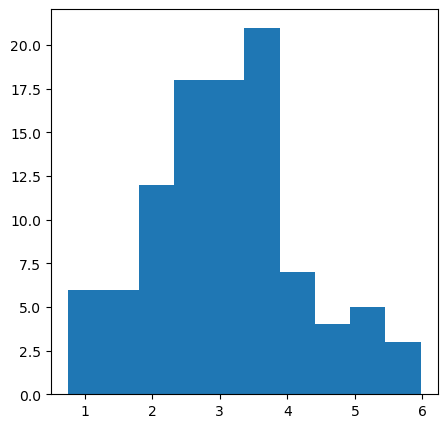

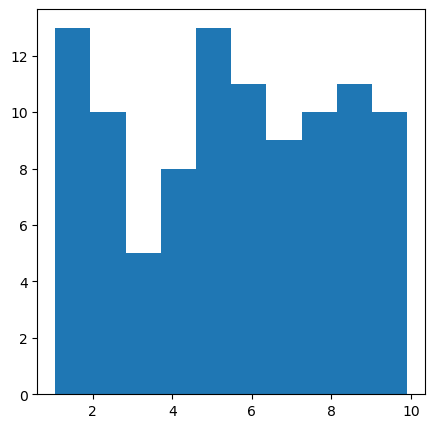

In [20]:
# https://www.tensorflow.org/api_docs/python/tf/random
# Public API for tf.random namespace.

# https://www.tensorflow.org/api_docs/python/tf/random/set_seed
# Sets the global random seed.
tf.random.set_seed(5);

# https://www.tensorflow.org/api_docs/python/tf/random/normal
# Outputs random values from a normal distribution.

# tf.random.normal(
#     shape,
#     mean=0.0,
#     stddev=1.0,
#     dtype=tf.dtypes.float32,
#     seed=None,
#     name=None
# )

print(tf.random.normal(shape=(3,3,1)))
print(tf.random.normal((3,3,1)))

tf.random.set_seed(5);
print(tf.random.normal((3,3,1)))

tf.random.set_seed(5);
print(tf.random.normal((3,3,1)))

t1 = tf.reshape(tf.random.shuffle(tf.range(12)), shape = (3, 4))
print(t1)

tensor_random_normal = tf.random.normal(mean=3, stddev=1, shape=(100,))
print('tensor_random_normal', tensor_random_normal)

import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(5, 5))
ax.hist(tensor_random_normal)

# https://www.tensorflow.org/api_docs/python/tf/random/uniform
# Outputs random values from a uniform distribution.

tensor_random_uniform = tf.random.uniform(shape=(100,), minval=1, maxval=10)
print('tensor_random_uniform', tensor_random_uniform)
fig, ax = plt.subplots(figsize=(5, 5))
ax.hist(tensor_random_uniform)

# Lab 002

> 문제 4
---
shape 이 3 x 16 x 16 인 tensor를 생성하시오.

단, 값은 모두 1로 설정하시오.

* **출력형식**


<tf.Tensor: shape=(3, 16, 16), dtype=float32, numpy=생략>

---

In [21]:
tf.ones(shape=(3, 16, 16)) # 모든 요소가 1인 텐서 만들기

<tf.Tensor: shape=(3, 16, 16), dtype=float32, numpy=
array([[[1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.

> 문제 5
---
shape 이 3 x 16 x 16 인 tensor를 3개 생성하시오.

* 첫 번째 tensor는 값이 모두 0
* 두 번째 tensor는 값이 모두 1
* 세 번째 tensor는 값이 모두 2

단, 3개의 tensors를 하나의 tensor 에 저장하시오.

* **출력형식**

<tf.Tensor: shape=(3, 3, 16, 16), dtype=float32, numpy=생략>

In [24]:
t1 = tf.zeros(shape=(3, 16, 16))
t2 = tf.ones(shape=(3, 16, 16))
# tf.fill(dims, value, name=None)
# dims: 생성하려는 텐서의 모양을 나타내는 정수형(배열)  / value: 생성된 텐서의 각 요소에 채울 값 / name (선택 사항): 텐서의 이름을 지정하는 문자열
t3 = tf.fill([3, 16, 16], 2.)
tf.stack([t1, t2, t3], axis=0)

<tf.Tensor: shape=(3, 3, 16, 16), dtype=float32, numpy=
array([[[[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]]],


       [[[1., 1., 1., ..., 1., 1., 1.],
         [1., 1., 1., ..., 1., 1., 1.],
         [1., 1., 1., ..., 1., 1., 1.],
         ...,
         [1., 1., 1., ..., 1., 1., 1.],


> 문제 6
---
shape 이 3 x 16 x 16 인 tensor (dtype=int32) 를 8개 생성하시오.

* tensor의 값은 0~255 범위의 random 정수값

단, 8개의 tensors를 하나의 tensor 에 저장하시오.

* **출력형식**

<tf.Tensor: shape=(8, 3, 16, 16), dtype=int32, numpy=생략>

In [25]:
tf.random.uniform(shape=(8, 3, 16, 16), minval=0, maxval=255, dtype=tf.int32)
# tf.random.uniform(shape, minval=0, maxval=None, dtype=tf.float32, seed=None, name=None)
# shape: 생성하려는 텐서의 모양을 나타내는 정수형(배열) / minval (선택 사항): 생성된 텐서의 값의 최솟값 / maxval (선택 사항): 생성된 텐서의 값의 최댓값 / dtype (선택 사항): 생성된 텐서의 데이터 타입 / seed (선택 사항): 난수 생성에 사용되는 시드(seed) 값으로, 재현 가능한 난수를 생성하기 위해 사용 / name (선택 사항): 텐서의 이름을 지정

<tf.Tensor: shape=(8, 3, 16, 16), dtype=int32, numpy=
array([[[[207, 117, 228, ..., 161, 182, 135],
         [ 63, 113, 164, ..., 232, 123,  23],
         [ 16, 192, 139, ..., 155, 165, 198],
         ...,
         [111,  12,  71, ...,   3,  25, 125],
         [ 44,  21, 182, ..., 136, 181,  54],
         [214, 101, 158, ...,  86, 206, 120]],

        [[ 88, 216,   2, ..., 137, 162,  11],
         [120, 237, 189, ...,  65,  29, 222],
         [224, 226,  37, ...,  23, 251, 161],
         ...,
         [195, 145, 137, ...,   8, 215,  39],
         [116, 221,  80, ..., 220, 112, 103],
         [235, 156, 129, ...,  96,  28, 180]],

        [[ 10,  42,  68, ..., 251, 146, 234],
         [169,   9,  24, ..., 195, 152, 253],
         [219,  91,  60, ..., 104, 105, 228],
         ...,
         [203, 141,  27, ..., 159,  86, 205],
         [208, 100,  11, ...,  22,  42, 217],
         [ 84,  16,  10, ..., 150, 228, 114]]],


       [[[134,  49, 182, ...,  28, 105, 204],
         [ 63,   4,  4

# 2.6 tensor operators

TensorFlow provides a variety of math functions including:

* **Basic arithmetic operators** and trigonometric functions.
* Special math functions (like: tf.math.igamma and tf.math.zeta)
* Complex number functions (like: tf.math.imag and tf.math.angle)
* **Reductions and scans** (like: tf.math.reduce_mean and tf.math.cumsum)
* Segment functions (like: tf.math.segment_sum)

In [26]:
# python list operators

lst = [1, 2, 3]
print('lst', lst)

# list multiplication with int
print('2 * lst', 2 * lst)

# adding two lists
print('lst+[4, 5]', lst + [4, 5])

# element-wise multiplication
print('list comprehension', [ x*4 for x in lst])

import operator
print('map(operator.mul, ...)', list(map(operator.mul, [4]*len(lst), lst)))

# print([1, 2, 3] < 0)

lst [1, 2, 3]
2 * lst [1, 2, 3, 1, 2, 3]
lst+[4, 5] [1, 2, 3, 4, 5]
list comprehension [4, 8, 12]
map(operator.mul, ...) [4, 8, 12]


In [ ]:
# https://www.tensorflow.org/api_docs/python/tf/math

# Basic arithmetic operators
t1 = tf.ones(shape=(2,3))
t_mul = 5 *t1
print('t_mul', t_mul, '\n')
t_add = 5 + t1
print('t_add', t_add, '\n')
t_sub = 5 - t1
print('t_sub', t_sub, '\n')
t_div = t1 / 5
print('t_div', t_div, '\n')
print('t1', t1, '\n')

t1 = tf.ones(shape=(2,3))
print('tf.multiply(t1, 5)', tf.multiply(t1, 5), '\n')
print('tf.add(t1, 5)', tf.add(t1, 5), '\n')
print('tf.subtract(t1, 5)', tf.subtract(t1, 5), '\n')
print('tf.divide(t1, 5)', tf.divide(t1, 5), '\n')
print('t1', t1, '\n')


print(t1 < 1)
print(t1 > 0)

In [ ]:
# Reductions

#1
a = tf.reshape(tf.range(12), shape = (3, 4))
print(a)

#2
print(tf.reduce_min(a))
print(tf.reduce_min(a, axis= 0))
print(tf.reduce_min(a, axis= 1))

#3
print(tf.reduce_max(a))
print(tf.reduce_max(a, axis= 0))
print(tf.reduce_max(a, axis= 1))

#4
print(tf.reduce_sum(a))
print(tf.reduce_sum(a, axis= 0))
print(tf.reduce_sum(a, axis= 1))

#5
print(tf.reduce_mean(a))
print(tf.reduce_mean(a, axis= 0))
print(tf.reduce_mean(a, axis= 1))

#6
print(tf.reduce_prod(a))
print(tf.reduce_prod(a, axis= 0))
print(tf.reduce_prod(a, axis= 1))

#7
t1 = tf.reshape(tf.random.shuffle(tf.range(12)), shape = (3, 4))
print(tf.argmin(a)) #  tf.argmin(a, axis =0)
print(tf.argmin(a, axis =1))
print(tf.argmax(a)) # tf.argmax(a, axis =0)
print(tf.argmax(a, axis =1))

#8
a = tf.random.shuffle(tf.range(12))
print(a)
print(tf.sort(a)) # direction="ASCENDING"
print(tf.sort(a, direction="DESCENDING"))

a = tf.reshape(a, shape=(3, 4))
print(a)
print(tf.sort(a)) # tf.sort(a, axis = 1)
print(tf.sort(a, axis = 0))

# Lab 003



> 문제 7
---
shape 이 3 x 16 x 16 인 tensor (dtype=flaot32) 를 8개 생성하시오.

* tensor의 값은 -1~1 범위의 random 실수값

단, 8개의 tensors를 하나의 tensor 에 저장하시오.

* **출력형식**

<tf.Tensor: shape=(8, 3, 16, 16), dtype=int32, numpy=생략>

t1.shape (8, 3, 16, 16)
MIN, MAX tf.Tensor(0, shape=(), dtype=int32) tf.Tensor(254, shape=(), dtype=int32)
t2 tf.Tensor(
[[[[0.161 0.315 0.398 ... 0.882 0.799 0.846]
   [0.394 0.228 0.37  ... 0.665 0.008 0.118]
   [0.567 0.846 0.15  ... 0.579 0.382 0.508]
   ...
   [0.882 0.358 0.65  ... 0.287 0.024 0.315]
   [0.13  0.031 0.169 ... 0.157 0.949 0.165]
   [0.457 0.606 0.299 ... 0.433 0.    0.531]]

  [[0.106 0.756 0.673 ... 0.555 0.909 0.421]
   [0.161 0.961 0.079 ... 0.323 0.421 0.382]
   [0.894 0.177 0.823 ... 0.217 0.11  0.665]
   ...
   [0.087 0.693 0.169 ... 0.685 0.39  0.5  ]
   [0.756 0.075 0.61  ... 0.441 0.028 0.669]
   [0.138 0.268 0.756 ... 0.165 0.996 0.346]]

  [[0.382 0.941 0.264 ... 0.457 0.35  0.575]
   [0.335 0.075 0.453 ... 0.433 0.5   0.878]
   [0.976 0.374 0.819 ... 0.756 0.441 0.791]
   ...
   [0.992 0.563 0.965 ... 0.831 0.894 0.465]
   [0.421 0.008 0.862 ... 0.913 0.709 0.083]
   [0.189 0.768 0.13  ... 0.705 0.406 0.126]]]


 [[[0.795 0.358 0.886 ... 0.953 0.606 0.

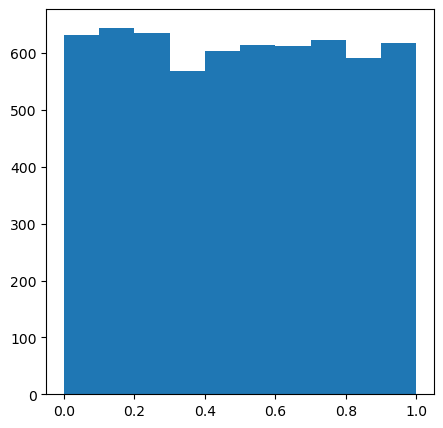

In [29]:
def show_hist_plot(x, x_range):
  import matplotlib.pyplot as plt
  fig, ax = plt.subplots(figsize=(5, 5))
  t = tf.reshape(x, [-1])
  print('x_range', x_range)
  ax.hist(t, range=x_range)


t1 = tf.random.uniform(shape=(8, 3, 16, 16), minval=0, maxval=255, dtype=tf.int32)
print('t1.shape', t1.shape)

MIN=tf.reduce_min(t1)
MAX=tf.reduce_max(t1)
print('MIN, MAX', MIN, MAX)

t2 = (t1-MIN)/(MAX-MIN)
print('t2', t2)
print('tf.reduce_min(t2)', tf.reduce_min(t2))
print('tf.reduce_max(t2)', tf.reduce_max(t2))
print('tf.reduce_mean(t2)', tf.reduce_mean(t2))

show_hist_plot(t2, [0, 1])

In [ ]:
MEAN = tf.reduce_mean(tf.cast(t1, dtype=tf.float32))
STDDEV = tf.math.reduce_std(tf.cast(t1, dtype=tf.float32))
print('MEAN, STDDEV', MEAN, STDDEV)

t4 = tf.cast(t1, dtype=tf.float32)-MEAN
t4 = t4/STDDEV
print('t4.shape', t4.shape)
print('tf.reduce_min(t4)', tf.reduce_min(t4))
print('tf.reduce_max(t4)', tf.reduce_max(t4))
print('tf.reduce_mean(t4)', tf.reduce_mean(t4))

show_hist_plot(t4, [tf.reduce_min(t4).numpy(), tf.reduce_max(t4).numpy()])


In [ ]:
tf.random.normal(shape=(8,3,16,16))

> 문제 8
---
주어진 MPG dataset을 이용하여 아래 통계값을 구하시오.

* 각 컬럼들의 합
* 각 컬럼들의 평균
* Horsepower 가 가장 큰 데이터의 인덱스 번호 (0부터 시작)
* 가장 작은 MPG 값

```python
#pip install -q seaborn
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
#import seaborn as sns

# Make NumPy printouts easier to read.
np.set_printoptions(precision=3, suppress=True)
import tensorflow as tf

url = 'http://archive.ics.uci.edu/ml/machine-learning-databases/auto-mpg/auto-mpg.data'
column_names = ['MPG', 'Cylinders', 'Displacement', 'Horsepower', 'Weight',
                'Acceleration', 'Model Year', 'Origin']

raw_dataset = pd.read_csv(url, names=column_names,
                          na_values='?', comment='\t',
                          sep=' ', skipinitialspace=True)
raw_dataset.head()
dataset = tf.Variable(raw_dataset)

```

In [27]:
# pip install -q seaborn
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
# import seaborn as sns

# Make NumPy printouts easier to read.
np.set_printoptions(precision=3, suppress=True)
import tensorflow as tf

url = 'http://archive.ics.uci.edu/ml/machine-learning-databases/auto-mpg/auto-mpg.data'
column_names = ['MPG', 'Cylinders', 'Displacement', 'Horsepower', 'Weight',
                'Acceleration', 'Model Year', 'Origin']

raw_dataset = pd.read_csv(url, names=column_names,
                          na_values='?', comment='\t',
                          sep=' ', skipinitialspace=True)
raw_dataset.head()

,MPG,Cylinders,Displacement,Horsepower,Weight,Acceleration,Model Year,Origin
0,18.0,8,307.0,130.0,3504.0,12.0,70,1
1,15.0,8,350.0,165.0,3693.0,11.5,70,1
2,18.0,8,318.0,150.0,3436.0,11.0,70,1
3,16.0,8,304.0,150.0,3433.0,12.0,70,1
4,17.0,8,302.0,140.0,3449.0,10.5,70,1


In [30]:
dataset = tf.Variable(raw_dataset)
print('sum of columns', tf.reduce_sum(dataset, axis=0))
print('mean of columns', tf.reduce_mean(dataset, axis=0))
max_horsepower_index = tf.argmax(dataset[:,3], axis=0)
print('max_horsepower_index', max_horsepower_index)
print('maximum horsepower', dataset[max_horsepower_index,3])
print('minimum MPG', tf.reduce_min(dataset[:,0]))


sum of columns tf.Tensor(
[   9358.8    2171.    76983.5       nan 1182229.     6196.1   30252.
     626. ], shape=(8,), dtype=float64)
mean of columns tf.Tensor([  23.515    5.455  193.426      nan 2970.425   15.568   76.01     1.573], shape=(8,), dtype=float64)
max_horsepower_index tf.Tensor(116, shape=(), dtype=int64)
maximum horsepower tf.Tensor(230.0, shape=(), dtype=float64)
minimum MPG tf.Tensor(9.0, shape=(), dtype=float64)


> 문제 9
---
주어진 이미지를 이용하여 다음 값을 계산하시오.

* 각 채널(RGB) 별 이미지의 평균값 (3개)
* 각 채널(RGB)을 평균값으로 병합 (이미지 한개)

```python
import tensorflow as tf

(x_train, y_train), (x_test, y_test) = tf.keras.datasets.cifar10.load_data()
print(x_train.shape)
print(x_train[0,].shape)
image = x_train[3,]

fig, ax = plt.subplots(figsize=(5,5))
ax.imshow(image)

```

170498071/170498071 [==============================] - 107s 1us/step
(50000, 32, 32, 3)
(32, 32, 3)


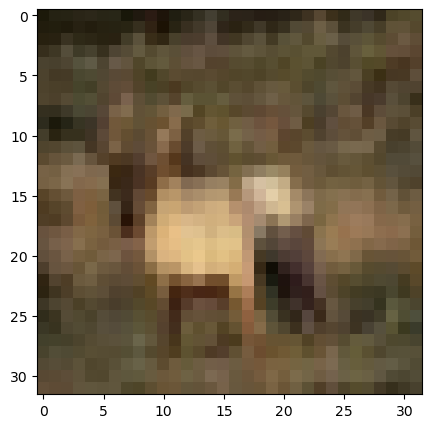

In [28]:
import tensorflow as tf

(x_train, y_train), (x_test, y_test) = tf.keras.datasets.cifar10.load_data()
print(x_train.shape)
print(x_train[0,].shape)
image = x_train[3,]

fig, ax = plt.subplots(figsize=(5,5))
ax.imshow(image)

In [31]:
tf.transpose(image, [2,0,1]).shape

TensorShape([3, 32, 32])

In [ ]:
tf.reduce_mean(image, axis=[0,1])

In [ ]:
tf.reduce_mean(tf.transpose(image, [2,0,1]), axis=[1,2])

In [ ]:
tf.reduce_mean(image, axis=[0,1])

# image_r = image[:,:,0]
# image_g = image[:,:,1]
# image_b = image[:,:,2]

# print('mean of channel r', tf.reduce_mean(image_r)) # 99
# print('mean of channel g', tf.reduce_mean(image_g)) # 83
# print('mean of channel b', tf.reduce_mean(image_b)) # 57

mean of all channels tf.Tensor(
[[21 30 31 ... 60 65 69]
 [24 26 23 ... 77 78 67]
 [28 30 46 ... 73 87 75]
 ...
 [69 73 70 ... 87 78 69]
 [70 72 75 ... 69 65 71]
 [77 74 73 ... 43 52 61]], shape=(32, 32), dtype=uint8)


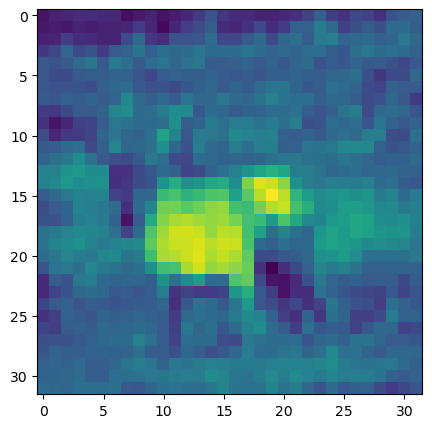

In [32]:
fig, ax = plt.subplots(figsize=(5,5))
ax.imshow(image)
merged_image = tf.reduce_mean(image, axis=2)
print('mean of all channels', merged_image)
ax.imshow(merged_image)

(32, 32)
(32, 32, 3)
mean of all channels tf.Tensor(
[[21 30 31 ... 60 65 69]
 [24 26 23 ... 77 78 67]
 [28 30 46 ... 73 87 75]
 ...
 [69 73 70 ... 87 78 69]
 [70 72 75 ... 69 65 71]
 [77 74 73 ... 43 52 61]], shape=(32, 32), dtype=uint8)


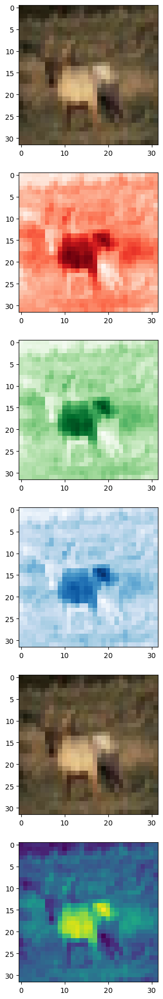

In [33]:
fig, axes = plt.subplots(6, figsize=(25, 25))
image_r = image[:,:,0]
image_g = image[:,:,1]
image_b = image[:,:,2]
print(image_r.shape)

axes[0].imshow(image)
axes[1].imshow(image_r, cmap='Reds')
axes[2].imshow(image_g, cmap='Greens')
axes[3].imshow(image_b, cmap='Blues')

image_all = tf.stack([image_r, image_g, image_b], axis=2)
print(image_all.shape)
axes[4].imshow(image_all)

merged_image = tf.reduce_mean(image, axis=2)
print('mean of all channels', merged_image)
axes[5].imshow(merged_image)

# 2.7 linear algebra

In [34]:
# https://www.tensorflow.org/api_docs/python/tf/linalg
# Operations for linear algebra.


import tensorflow as tf
#1 norm
a = tf.constant([1, 2, 3], dtype=tf.float32)
print('a', a)
print('tf.norm(a)', tf.norm(a)) # tf.linalg.norm(a)

#2 transpose
A = tf.constant([[1, 2], [3, 4]], dtype=tf.float32)
print('A', A)
print('tf.linalg.matrix_transpose(A)', tf.linalg.matrix_transpose(A))

#3 determinant
print('tf.linalg.det(A)', tf.linalg.det(A))

#4 inverse matrix
B =  tf.linalg.inv(A)
print('B', B)

#5 matrix multiplication
print('tf.matmul(A, B)', tf.matmul(A, B))  # tf.linalg.matmul(A, B)


a tf.Tensor([1. 2. 3.], shape=(3,), dtype=float32)
tf.norm(a) tf.Tensor(3.7416575, shape=(), dtype=float32)
A tf.Tensor(
[[1. 2.]
 [3. 4.]], shape=(2, 2), dtype=float32)
tf.linalg.matrix_transpose(A) tf.Tensor(
[[1. 3.]
 [2. 4.]], shape=(2, 2), dtype=float32)
tf.linalg.det(A) tf.Tensor(-2.0, shape=(), dtype=float32)
B tf.Tensor(
[[-2.   1. ]
 [ 1.5 -0.5]], shape=(2, 2), dtype=float32)
tf.matmul(A, B) tf.Tensor(
[[ 1.  0.]
 [-0.  1.]], shape=(2, 2), dtype=float32)


matrix equation

Ax = b

==> x = A<sup>-1</sup> x b

A<sup>-1</sup> = $\frac{1}{DET(A)}$ A

In [35]:

#1 Ax = b


A = tf.constant([[1, 4,  1],
                 [1, 6, -1],
                 [2, -1, 2]], dtype=tf.float32)

b = tf.constant([[ 7],
                 [13],
                 [ 5]], dtype=tf.float32)

#2 DET(A)
print(tf.linalg.det(A))

# x = A^-1 x b
x = tf.matmul(tf.linalg.inv(A), b)
print('x', x)

#3
def all_close(x, y, tol=1e-5):
         return tf.reduce_sum(tf.square(x - y)) < tol
print(all_close(tf.matmul(A, x), b))

#4
x = tf.linalg.solve(A, b)
print(x)
print(all_close(tf.matmul(A, x), b))


tf.Tensor(-18.000006, shape=(), dtype=float32)
x tf.Tensor(
[[ 5.]
 [ 1.]
 [-2.]], shape=(3, 1), dtype=float32)
tf.Tensor(True, shape=(), dtype=bool)
tf.Tensor(
[[ 5.]
 [ 1.]
 [-2.]], shape=(3, 1), dtype=float32)
tf.Tensor(True, shape=(), dtype=bool)


LU decomposition

A = LU 로 분해하여

Ax = b linear equations 을 푸는 과정에 활용해 보면,

=> LUx = b

=> Ux = Z  로 놓고

=> LZ = b  를 풀고

=> Ux = z 를 풀면

x 를 구할 수 있음
(역행렬 방법과 비교하여 빠르고, 메모리 적게 사용해서 계산 가능)

In [36]:

# A = tf.constant([[1,1,1],
#              [4,3,-1],
#              [3,5,3]], dtype=tf.float32)

# A = tf.constant([[3,-7,-2, 2],
#              [-3,5,1,0],
#              [6,-4,0,-5],
#              [-9,5,-5,12]], dtype=tf.float32)

A = tf.constant([[1, 4,  1],
                 [1, 6, -1],
                 [2, -1, 2]], dtype=tf.float32)

print('A', A)

# https://www.tensorflow.org/api_docs/python/tf/linalg/lu
# Computes the LU decomposition of one or more square matrices.

# The input is a tensor of shape [..., M, M]
# whose inner-most 2 dimensions form square matrices.

# The input has to be invertible.

# The output consists of two tensors LU and P
# containing the LU decomposition of all input submatrices [..., :, :].

# LU encodes the lower triangular and upper triangular factors.

lu, p = tf.linalg.lu(A)

print('tf.linalg.lu(A)', lu, p)

L = tf.linalg.band_part(lu,-1,0) - tf.linalg.diag(tf.linalg.diag_part(lu)) + tf.linalg.diag(tf.ones(shape = lu.shape[0],))
U = tf.linalg.band_part(lu, 0, -1)
permu_operator = tf.linalg.LinearOperatorPermutation(p)
P = permu_operator.to_dense()

print('L', L)
print('U', U)

AA = tf.matmul(P, tf.matmul(L,U), transpose_a = True)
print('AA', AA)

AAA = tf.linalg.lu_reconstruct(lu, p)
print('AAA', AAA)

#4: solve AX = b using PLUx = b
b = tf.constant([[ 7],
                 [13],
                 [ 5]], dtype=tf.float32)

tf.linalg.lu_solve(lu, p, b)

A tf.Tensor(
[[ 1.  4.  1.]
 [ 1.  6. -1.]
 [ 2. -1.  2.]], shape=(3, 3), dtype=float32)
tf.linalg.lu(A) tf.Tensor(
[[ 2.    -1.     2.   ]
 [ 0.5    6.5   -2.   ]
 [ 0.5    0.692  1.385]], shape=(3, 3), dtype=float32) tf.Tensor([2 1 0], shape=(3,), dtype=int32)
L tf.Tensor(
[[1.    0.    0.   ]
 [0.5   1.    0.   ]
 [0.5   0.692 1.   ]], shape=(3, 3), dtype=float32)
U tf.Tensor(
[[ 2.    -1.     2.   ]
 [ 0.     6.5   -2.   ]
 [ 0.     0.     1.385]], shape=(3, 3), dtype=float32)
AA tf.Tensor(
[[ 1.  4.  1.]
 [ 1.  6. -1.]
 [ 2. -1.  2.]], shape=(3, 3), dtype=float32)
AAA tf.Tensor(
[[ 1.  4.  1.]
 [ 1.  6. -1.]
 [ 2. -1.  2.]], shape=(3, 3), dtype=float32)


<tf.Tensor: shape=(3, 1), dtype=float32, numpy=
array([[ 5.],
       [ 1.],
       [-2.]], dtype=float32)>

[1차 함수](https://www.geogebra.org/m/vu5eJ5K9)

y = ax + b


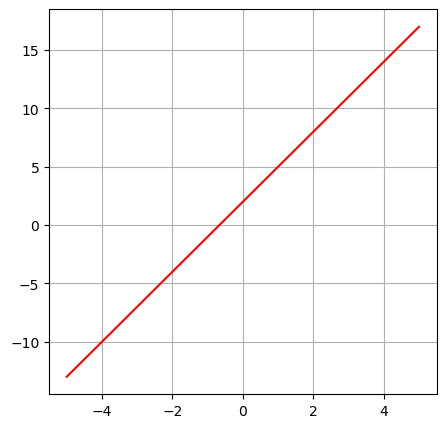

In [37]:
import matplotlib.pyplot as plt
import tensorflow as tf

x = tf.linspace(-5,5,10)
y = 3*x+2
fig, ax = plt.subplots(figsize=(5,5))
ax.grid()
ax.plot(x, y, '-r')

(0, 6), (1, 0), (2, 0) 을 지나는 가장 가까운 직선의 방정식은?

6 = a x 0 + b

0 = a x 1 + b

0 = a x 2 + b

위 수식을 모두 만족하는 a 는 존재하는가?

=> 존재하지 않으면 **차이가 최소(에러가 최소)**가 되는 근사값 $\hat{a}$ 을 구해보자!

Error<sup>2</sup> = (6 - (a x 0 + b))<sup>2</sup> + (0 - (a x 1 + b))<sup>2</sup> + (0 - (a x 2 + b))<sup>2</sup>

=> 2차 방정식이므로 $\hat{a}$ 과 $\hat{b}$ 에 대해 미분하자!

=> 행렬로 풀려면 공식 이용

$X = \begin{bmatrix}\hat{a}\\
\hat{b}
\end{bmatrix}$

(A<sup>T</sup>A)X = A<sup>T</sup>b

In [38]:
A = tf.constant([[0, 1],
		 [1, 1],
		 [2, 1]], dtype=tf.float32)

b = tf.constant([[ 6],
                 [ 0],
                 [ 0]], dtype=tf.float32)

# Dividend ÷ Divisor = Quotient + Remainder

At = tf.transpose(A)
Dividend = tf.matmul(At, b)
Divisor = tf.matmul(At, A)
print('Dividend', Dividend)
print('Divisor', Divisor)
InvDivisor = tf.linalg.inv(Divisor)
print('Inverse of Divisor', InvDivisor)
X = tf.matmul(InvDivisor, Dividend)
print('X', X)
# a = X.numpy()[0]
# b = X.numpy()[1]
# print('a, b', a, b)
tf.linalg.solve(Divisor, Dividend)

# https://www.tensorflow.org/api_docs/python/tf/linalg/lstsq
# Solves one or more linear least-squares problems.
tf.linalg.lstsq(A, b)

Dividend tf.Tensor(
[[0.]
 [6.]], shape=(2, 1), dtype=float32)
Divisor tf.Tensor(
[[5. 3.]
 [3. 3.]], shape=(2, 2), dtype=float32)
Inverse of Divisor tf.Tensor(
[[ 0.5   -0.5  ]
 [-0.5    0.833]], shape=(2, 2), dtype=float32)
X tf.Tensor(
[[-3.]
 [ 5.]], shape=(2, 1), dtype=float32)


<tf.Tensor: shape=(2, 1), dtype=float32, numpy=
array([[-3.],
       [ 5.]], dtype=float32)>

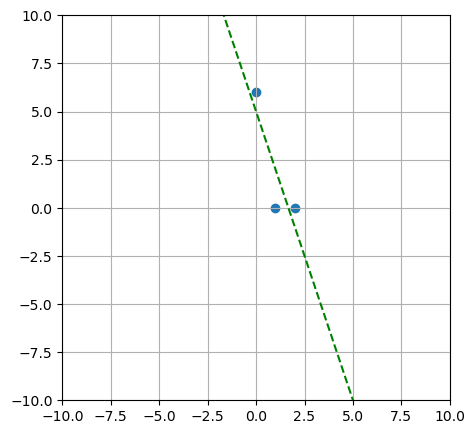

In [39]:
x = [0, 1, 2]
y = [6, 0, 0]
fig, ax = plt.subplots(figsize=(5,5))
ax.grid()
plt.xlim([-10, 10])
plt.ylim([-10, 10])
ax.scatter(x, y)
xx = tf.linspace(-10, 10, 10)
yy = -3 * xx + 5   # -3과 5는 어떻게 알 수 있었나?
ax.plot(xx, yy, '--g')

# 2.7 linear regression

https://www.statskingdom.com/linear-regression-calculator.html

In [40]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

In [41]:
def plot_function(f, title=None, min=-2.1, max=2.1, color='r', ylim=None):
    x = tf.linspace(min,max, 100)
    if ylim: plt.ylim(ylim)
    plt.plot(x, f(x), color)
    if title is not None: plt.title(title)

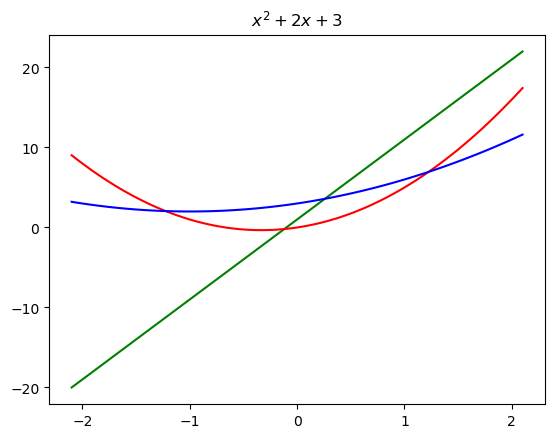

In [42]:
def f1(x): return 10*x + 1
def f2(x): return 3*x**2 + 2*x
def f3(x): return x**2 + 2*x + 3

plot_function(f1, "$10x + 1$", color='green')
plot_function(f2, "$3x^2 + 2x$", color='red')
plot_function(f3, "$x^2 + 2x + 3$", color='blue')

In [43]:
# Imports for JupyterLite
%pip install -q ipywidgets

Note: you may need to restart the kernel to use updated packages.


In [44]:
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

In [45]:
from functools import partial

1000


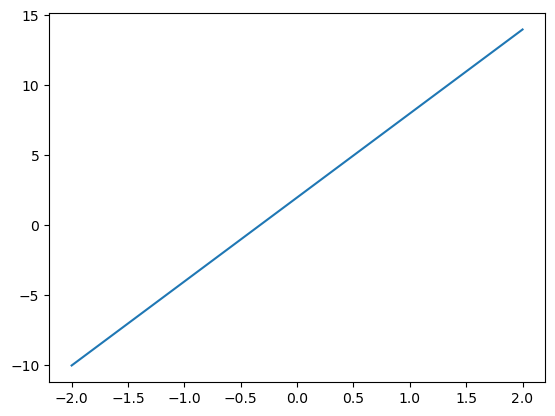

In [46]:
def line(a, b, x):
    return a*x + b

def mk_line (a, b):
    return partial(line, a,b)

def deriv(x):
    return 6*x + 2

grad_hist = []
x_hist = np.linspace(-2, 2, 1000)
for i in x_hist:
  grad_hist.append(deriv(i))
print(len(grad_hist))
plt.plot(x_hist, grad_hist)
plt.show()

In [47]:
#%matplotlib notebook
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

C:\Users\user\AppData\Local\Temp\ipykernel_7620\2403373673.py:23: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  point.set_data(x_hist[i], grad_hist[i])
Animation size has reached 20976596 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


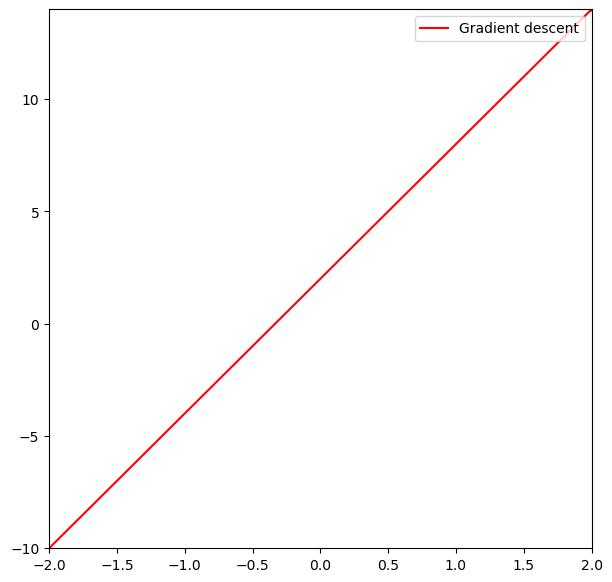

In [48]:
#Plot the contour
fig1, ax1 = plt.subplots(figsize = (7,7))

# Create animation
line, = ax1.plot([], [], 'r', label = 'Gradient descent', lw = 1.5)
point, = ax1.plot([], [], '*', color = 'red', markersize = 4)
value_display = ax1.text(0.02, 0.02, '', transform=ax1.transAxes)

def init_1():
    line.set_data([], [])
    point.set_data([], [])
    ax1.set_xlim(min(x_hist), max(x_hist))
    ax1.set_ylim(min(grad_hist), max(grad_hist))
    #value_display.set_text('')

    return line, point

def animate_1(i):
    # Animate line
    line.set_data(x_hist[:i], grad_hist[:i])

    # Animate points
    point.set_data(x_hist[i], grad_hist[i])

    # Animate value display
    #value_display.set_text('Min = ' + str(J_history_reg[i]))

    return line, point

ax1.legend(loc = 1)

anim1 = FuncAnimation(fig1, animate_1, init_func=init_1,
                               frames=len(grad_hist), interval=100,
                               repeat_delay=60, blit=True)
#plt.show()
HTML(anim1.to_jshtml())

# 2.8 gradient decent


Error = (y-$\hat{y}$)<sup>2</sup>

Mean Squared Error

$$\frac{1}{n}\sum_{i=1}^{n}(y-\hat{y})^2$$


예) $x^2 -2x + 1$

[2차 함수](https://www.geogebra.org/m/xgdQkfk3)


x <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=4.0>


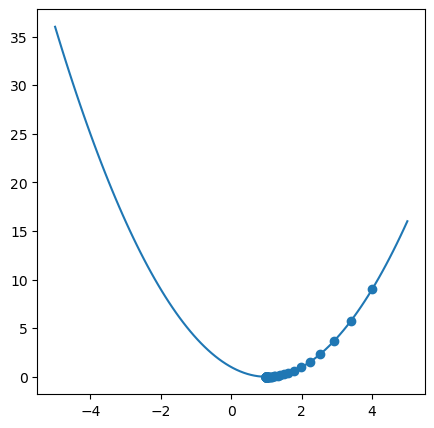

In [49]:
def f(x):
  return x**2 - 2*x + 1

def f_prime(x):
  h = 0.01
  return (f(x+h)-f(x)) / h

def f_prime2(x):
  return 2*x + 2

all_x = tf.linspace(-5,5,100)
all_y = f(all_x)

x = tf.Variable(4.) # initial value
LR = 0.1
print('x', x)
x_history, y_history = [], []
for _ in range(100):
  y = f(x)
  step1 = LR*f_prime(x)
  step2 = LR*f_prime2(x)
  x_history.append(x.numpy())
  y_history.append(y.numpy())

  x.assign_sub(step1)

fig, ax = plt.subplots(figsize=(5,5))
ax.plot(all_x, all_y)
ax.scatter(x_history, y_history)
